In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [2]:
austin = gpd.read_file('../data/neighbourhoods.geojson')
print(austin.crs)
austin.head()

epsg:4326


,neighbourhood,neighbourhood_group,geometry
0,78739,None,"MULTIPOLYGON (((-97.89002 30.20941, -97.88929 ..."
1,78754,None,"MULTIPOLYGON (((-97.63658 30.40266, -97.63754 ..."
2,78732,None,"MULTIPOLYGON (((-97.87303 30.43806, -97.87335 ..."
3,78737,None,"MULTIPOLYGON (((-98.01876 30.24167, -98.01617 ..."
4,78756,None,"MULTIPOLYGON (((-97.72792 30.32906, -97.72760 ..."


In [3]:
type(austin)

geopandas.geodataframe.GeoDataFrame

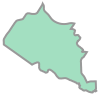

In [4]:
austin.loc[0, 'geometry']

In [5]:
print(austin.loc[0, 'geometry'])

MULTIPOLYGON (((-97.890016 30.209412, -97.889286 30.208708, -97.888672 30.207904, -97.88822 30.207299, -97.88751999999999 30.206345, -97.886872 30.205469, -97.886517 30.205022, -97.88602899999999 30.204487, -97.88542 30.203912, -97.884924 30.203498, -97.884474 30.203157, -97.884007 30.202848, -97.883473 30.202527, -97.88299000000001 30.202254, -97.88250600000001 30.202013, -97.88190299999999 30.201707, -97.88138600000001 30.201494, -97.880723 30.201256, -97.879919 30.200993, -97.879385 30.200851, -97.878781 30.200713, -97.878058 30.200553, -97.877606 30.200478, -97.876957 30.200411, -97.876312 30.200365, -97.87568 30.200342, -97.875091 30.200326, -97.874472 30.200349, -97.873762 30.200394, -97.873041 30.200473, -97.872354 30.200575, -97.87180600000001 30.200691, -97.871298 30.200814, -97.870575 30.200965, -97.870402 30.201, -97.870068 30.201057, -97.869675 30.20111, -97.869287 30.201144, -97.868994 30.201157, -97.86872700000001 30.201166, -97.86836599999999 30.201156, -97.868055 30.201

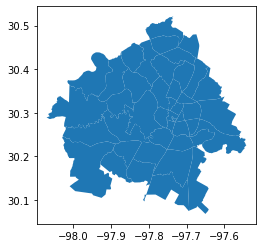

In [6]:
austin.plot();

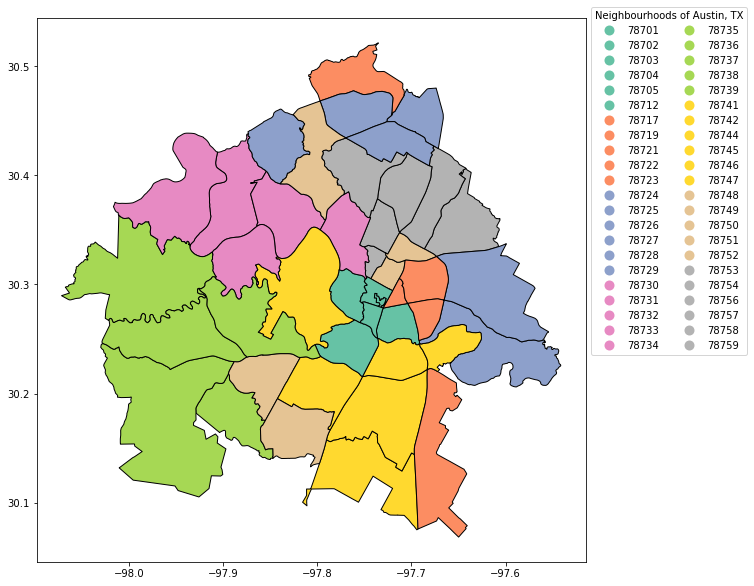

In [7]:
leg_kwds = {'title': 'Neighbourhoods of Austin, TX', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}

austin.plot(column = 'neighbourhood', figsize=(10, 10),
              edgecolor = 'black',
              legend = True, legend_kwds = leg_kwds, 
              cmap = 'Set2')
plt.show()

In [8]:
airbnb = pd.read_csv('../data/listings.csv')
print(airbnb.shape)
airbnb.head(3)

(18337, 18)


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,319887,Quaint East Austin 2BR SXSW 2016,1640158,Jeremy,NaN,78702,30.25328,-97.72968,Entire home/apt,694,4,2,2015-03-18,0.02,1,0,0,NaN
1,319894,The Perfect Austin Modern Home,1640172,Gary,NaN,78724,30.28354,-97.64966,Entire home/apt,192,2,171,2022-09-11,1.34,2,156,36,NaN
2,46856014,"Electric Fireplace+Fire Pit, Lake Fishing + ka...",375760981,Niza,NaN,78611,30.80862,-98.37400,Entire home/apt,194,2,88,2022-08-28,4.17,1,342,47,NaN


In [9]:
airbnb = airbnb[['id','name','neighbourhood','latitude','longitude','room_type','price']]

In [10]:
airbnb.head(3)

,id,name,neighbourhood,latitude,longitude,room_type,price
0,319887,Quaint East Austin 2BR SXSW 2016,78702,30.25328,-97.72968,Entire home/apt,694
1,319894,The Perfect Austin Modern Home,78724,30.28354,-97.64966,Entire home/apt,192
2,46856014,"Electric Fireplace+Fire Pit, Lake Fishing + ka...",78611,30.80862,-98.37400,Entire home/apt,194


In [11]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18337 entries, 0 to 18336
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             18337 non-null  int64  
 1   name           18337 non-null  object 
 2   neighbourhood  18337 non-null  int64  
 3   latitude       18337 non-null  float64
 4   longitude      18337 non-null  float64
 5   room_type      18337 non-null  object 
 6   price          18337 non-null  int64  
dtypes: float64(2), int64(3), object(2)
memory usage: 1002.9+ KB


In [12]:
airbnb['geometry'] = airbnb.apply(lambda x: Point((x.longitude, 
                                                x.latitude)), 
                                        axis=1)
airbnb.head(3)

,id,name,neighbourhood,latitude,longitude,room_type,price,geometry
0,319887,Quaint East Austin 2BR SXSW 2016,78702,30.25328,-97.72968,Entire home/apt,694,POINT (-97.72968 30.25328)
1,319894,The Perfect Austin Modern Home,78724,30.28354,-97.64966,Entire home/apt,192,POINT (-97.64966 30.28354)
2,46856014,"Electric Fireplace+Fire Pit, Lake Fishing + ka...",78611,30.80862,-98.37400,Entire home/apt,194,POINT (-98.374 30.80862)


In [13]:
atx_geo = gpd.GeoDataFrame(airbnb, 
                           crs = austin.crs, 
                           geometry = airbnb['geometry'])

In [14]:
type(atx_geo)

geopandas.geodataframe.GeoDataFrame

In [15]:
austin.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [16]:
atx_area_center = ['30.27','-97.74']
print(atx_area_center)  

['30.27', '-97.74']


In [ ]:
map_atx = folium.Map(location = atx_area_center, zoom_start = 12)
map_atx

In [17]:
i = 0
for row_index, row_values in airbnb.iterrows():
    if i <3: 
       print('index is', row_index)
       print('values are:')
       print(' ')
       print(row_values)
       print('------------------------- ')
       i+=1

index is 0
values are:
 
id                                         319887
name             Quaint East Austin 2BR SXSW 2016
neighbourhood                               78702
latitude                                 30.25328
longitude                               -97.72968
room_type                         Entire home/apt
price                                         694
geometry               POINT (-97.72968 30.25328)
Name: 0, dtype: object
------------------------- 
index is 1
values are:
 
id                                       319894
name             The Perfect Austin Modern Home
neighbourhood                             78724
latitude                               30.28354
longitude                             -97.64966
room_type                       Entire home/apt
price                                       192
geometry             POINT (-97.64966 30.28354)
Name: 1, dtype: object
------------------------- 
index is 2
values are:
 
id                                       

In [ ]:
map_atx = folium.Map(location =  atx_area_center, zoom_start = 12)


for row_index, row_values in airbnb.iterrows():
    loc = [row_values['latitude'], row_values['longitude']]
    pop = str(row_values['name'])
    icon=folium.Icon(color="orange",icon="home", prefix='fa')
    marker = folium.Marker(
    location = loc, 
    popup = pop, icon = icon)
    marker.add_to(map_atx)


map_atx.save('../maps/atxairbnb.html')


map_atx

In [18]:
cluster_map_atx = folium.Map(location =  atx_area_center, zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_map_atx)


for row_index, row_values in airbnb.iterrows():
    loc = [row_values['latitude'], row_values['longitude']]
    pop = str(row_values['name'])
    icon=folium.Icon(color="orange",icon="home", prefix='fa')
    marker = folium.Marker(
    location = loc, 
    popup = pop, icon = icon)
    marker.add_to(marker_cluster)
    
cluster_map_atx.save('../maps/atxairbnbcluster.html')

cluster_map_atx